# EDA

### Global

In [62]:
random_state = 42

### Basic stats

In [63]:
from utils import read_data
from utils import print_basic_statistics


data = read_data('./input/train.csv')

print_basic_statistics(data, 'mutation')

Shape = (180000, 32)

Columns = ['ID' 'sequence1' 'sequence2' 'sequence3' 'sequence4' 'sequence5'
 'sequence6' 'sequence7' 'sequence8' 'sequence9' 'A' 'B' 'C' 'D' 'E' 'F'
 'G' 'H' 'I' 'J' 'K' 'L' 'M' 'N' 'O' 'P' 'Q' 'R' 'S' 'T' 'U' 'mutation']

First 15 samples:
    ID     sequence1     sequence2     sequence3     sequence4     sequence5     sequence6     sequence7     sequence8     sequence9  ...         M         N         O         P         Q         R         S         T         U  mutation
0    0  ATGCGCTTAATT  ATGCGCTTAATT  ATGCGCTTAATT  ATGCGCTTAATT  ATGCGCTTAATT  AAATCAGCTAAA  ATTCCATATTTT  ATTCCATATTTT  AAATCAGCTAAA  ...  0.759439  0.795549  0.681917  0.621672  0.592184  0.791921  0.815254  0.965006  0.665915         0
1    2  ATGCGCTTAATT  ATGCGCTTAATT  GATCGTAGCTAA  ATGCGCTTAATT  ATGCGCTTAATT  AAATCAGCTAAA  ATTCCATATTTT  ATTCCATATTTT  AAATCAGCTAAA  ...  0.343255  0.616352  0.793687  0.552877  0.352113  0.388835  0.412303  0.292696  0.549452         0
2    5  ATGCGCTTAATT  A

### Checking missings

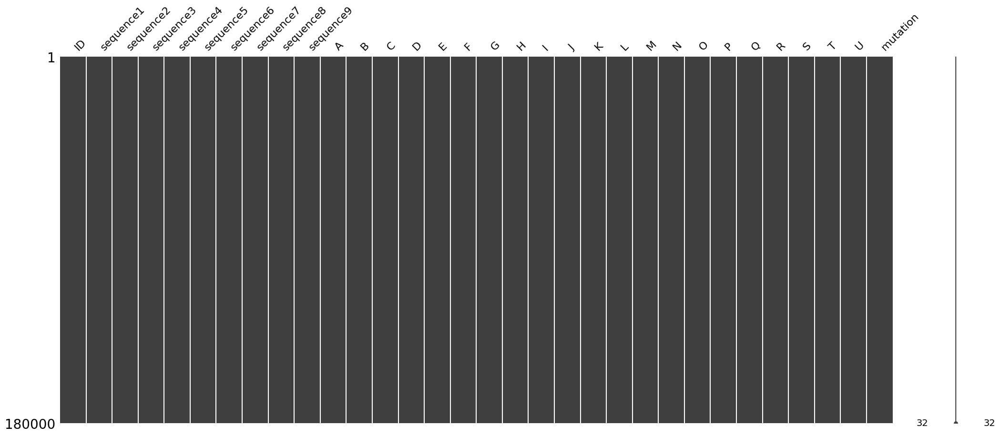

<Figure size 1500x900 with 0 Axes>

In [64]:
from utils import show_data_missings

show_data_missings(data)

No missings

### Base data preprocessing for EDA

In [278]:
from utils import label_encode_string_values
from sklearn.preprocessing import StandardScaler
import pandas as pd


std_scaler = StandardScaler()

eda_preprocessed_data = data.drop('ID', axis=1)
eda_preprocessed_data = label_encode_string_values(eda_preprocessed_data)
eda_preprocessed_data = pd.DataFrame(data=std_scaler.fit_transform(eda_preprocessed_data), columns=eda_preprocessed_data.columns)

### Features correlation

In [279]:
from utils import corr_feature_detect


corr = corr_feature_detect(data=eda_preprocessed_data, threshold=0.8)

print('Top correlations:\n')
for i in corr:
    print(i, '\n')

Top correlations:

  feature1 feature2    corr
0        M        L  0.8614 

  feature1 feature2    corr
1        L        M  0.8614 

  feature1 feature2      corr
2        U        K  0.807413 

  feature1 feature2      corr
3        K        U  0.807413 



No big correlations between target and features

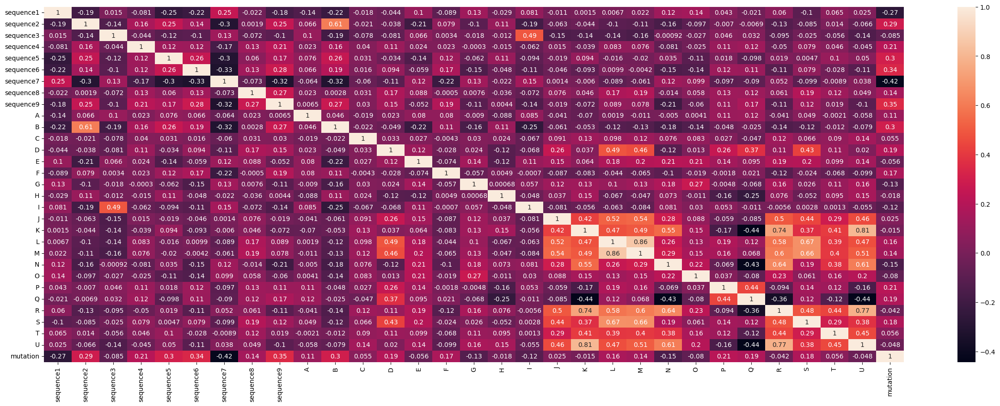

In [ ]:
from utils import plot_corr_matrix


plot_corr_matrix(eda_preprocessed_data, figsize=(30, 10))

### Features distributions

In [ ]:
from utils import pair_plot


pair_plot(eda_preprocessed_data, target='mutation')

Non-linear classes distribution

# Base preprocessing

In [65]:
X = data.drop('mutation', axis=1)

In [66]:
y = data.mutation

In [67]:
from sklearn.model_selection import train_test_split


X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.15, random_state=random_state)

In [68]:
X_train.reset_index(drop=True, inplace=True)
X_test.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)

In [69]:
def drop_extra_features(data):
    return data.drop(['ID'], axis=1)

In [70]:
from sklearn.preprocessing import FunctionTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

from utils import label_encode_string_values


preprocessing_steps = [
    ('drop_extra_features', FunctionTransformer(drop_extra_features)),
    ('label_encode', FunctionTransformer(label_encode_string_values)),
    ('scaler', StandardScaler())
]

preprocess_pipeline = Pipeline(preprocessing_steps)

In [71]:
X_train = preprocess_pipeline.fit_transform(X_train)
X_test = preprocess_pipeline.transform(X_test)

Saving preprocess pipeline to file

In [72]:
from utils import save_pyobj_to_file


save_pyobj_to_file(preprocess_pipeline, './preprocess_pipeline.pkl')

# Processing train outliers

In [73]:
import importlib
imported_module = importlib.import_module('utils')
importlib.reload(imported_module);

In [74]:
from utils import outlier_detect
from utils import concat_outliers
from utils import ndarray_to_dataframe


outliers = {}

for i in (chr(x) for x in range(ord('A'), ord('U'))):
    outliers[i] = outlier_detect(dataset=ndarray_to_dataframe(X_train, columns=X.columns[1:]), col=i, threshold=5, method='std', print_summary=False)

for column, column_outliers in outliers.items():
    outlier_index, param = column_outliers
    print(f'column={column} count outliers={outlier_index.sum()}')

global_outlier_index = concat_outliers(outliers)

print(f'Total outliers count: {global_outlier_index.sum()}')
print(f'Total outliers share: {global_outlier_index.sum()/len(X)}')

column=A count outliers=0
column=B count outliers=0
column=C count outliers=1041
column=D count outliers=590
column=E count outliers=0
column=F count outliers=506
column=G count outliers=0
column=H count outliers=0
column=I count outliers=298
column=J count outliers=0
column=K count outliers=0
column=L count outliers=0
column=M count outliers=0
column=N count outliers=0
column=O count outliers=0
column=P count outliers=0
column=Q count outliers=0
column=R count outliers=0
column=S count outliers=0
column=T count outliers=0
Total outliers count: 2401
Total outliers share: 0.01333888888888889


Count of outliers < 5%. Removing them from training set

In [75]:
X_train = ndarray_to_dataframe(X_train)[~global_outlier_index].values
y_train = ndarray_to_dataframe(y_train)[~global_outlier_index].values

# Undersampling

### RandomUnderSampler

In [76]:
from imblearn.under_sampling import RandomUnderSampler

rus = RandomUnderSampler(replacement=True, random_state=random_state)

X_train_resampled_random, y_train_resampled_random = rus.fit_resample(X_train, y_train)

In [77]:
X_train_resampled_random.shape

(78964, 30)

# Best model

In [78]:
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import VotingClassifier

In [79]:
from utils import basic_model_test
from utils import plot_roc_curve

In [80]:
best_estimator = VotingClassifier(
    estimators=[('svc', BaggingClassifier(estimator=SVC(max_iter=1000000, random_state=random_state, probability=True), n_estimators=5, max_samples=40000, bootstrap=False, n_jobs=-1, random_state=random_state)),
                ('bag', BaggingClassifier(estimator=DecisionTreeClassifier(random_state=random_state), n_estimators=1000, max_samples=40000, bootstrap=False, n_jobs=-1, random_state=random_state)),
                ],
    voting='soft',
    weights=[0.3, 0.7])

In [81]:
basic_model_test(
    best_estimator, 
    X_train_resampled_random,
    X_test,
    y_train_resampled_random, 
    y_test)

ROC AUC:   0.882
Accuracy:  0.804
Precision: 0.596
Recall:    0.798
F1-score:  0.683


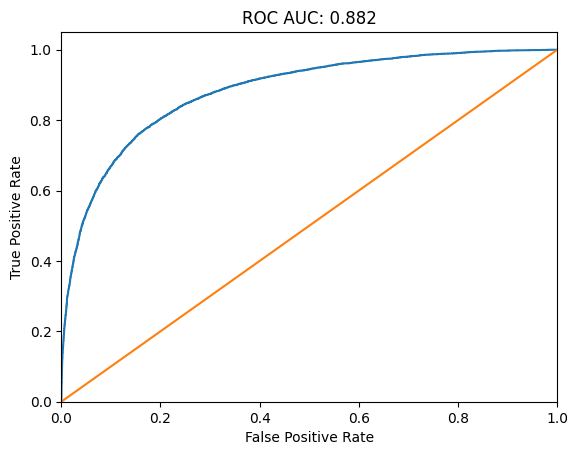

In [82]:
plot_roc_curve(y_test, best_estimator.predict_proba(X_test))

Saving estimator to file

In [83]:
from utils import save_pyobj_to_file


save_pyobj_to_file(best_estimator, './mutation_estimator.pkl')

In [ ]:
X_train.reset_index(drop=True, inplace=True)
X_test.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)

# Summary report:


My attempts are presented in files 'mutation_probability_label_enc.ipynb' and 'mutation_probability_onehot_enc.ipynb'.<br>
In this summary I describe only steps that lead me to the best model I got.


1. Was performed basic data statistics researsh:
    - We can see class imbalance between samples with/wihout mutation (132k/47k).
    - No missing values in dataset.<br><br>
2. EDA:
    - Was performed features correlation research:<br>
        Correlation matrix shows that in our case we don't have features with correlation level higher then 86.14%.<br>
        So, we don't have multicollinear features to drop.
    - Was displayed pair plot:<br>
        It's complicated to find some linear distribution between classes with this plot.<br>
        So we can assume that classes are non-linear separated.<br><br>
3. Splitting data to train/test. For test we saved 15% of dataset.<br><br>
4. Data preprocessing:
    - column 'ID' was removed
    - strings were encoded with label encode approach
    - numerical features were scaled using standard scaler<br><br>
5. Processing outliers for train:
    - To remove outliers was used standard deviation method. Threshold for outliers was set to 5 std.<br><br>
6. To enhance training speed was used random under sampling method.<br><br>
7. Selecting best model:<br><br>
    Following all previous steps the best quality was given by soft voting classifier based on SVC and DecisionTree classifier.<br>
    To enhance each of base classifiers (SVC, DecisionTree) was used bagging, because it helps to reduce variance, which can be usefull in case of dataset with a lot of noise.<br>
    Both of these models (SVC, DecisionTree) showed good quality results, that's why was decided to combine them in one voter with larger weight for DecisionTrees.<br>
    From my point of view the most important metrics in our case were ROC-AUC score and recall.<br>
    ROC-AUC score show general classifing power of model which is especially important in case when classes are imbalanced.<br>
    And the second important score from my point of view is recall in this case. Because if we are talking about some medical cases it would be better to make an error predicing mutation then not to detect it at all.<br><br>
8. Final metrics:
    - ROC-AUC score: <b>0.882</b>
    - recall: <b>0.798</b><br><br>
9. Attachments:
    - <b>'./preprocess_pipeline.pkl'</b> - preprocessing pipeline
    - <b>'./mutation_estimator.pkl'</b> - mutation estimator
    - <b>'./y_pred_validation.csv'</b> - predictions for validation set<br><br>

10. Attachments link: (can't upload pkl files to git because of size limitations)<br>
    https://drive.google.com/drive/folders/1EB4XJCNIUKWnvMpgP_kaXDyjQMW0oTF6?usp=sharing

# Saving predictions for validation set to csv

In [84]:
X_validation = read_data('./input/test.csv')

X_validation = preprocess_pipeline.transform(X_validation)
y_pred_validation = best_estimator.predict(X_validation)

In [85]:
from utils import ndarray_to_csv


ndarray_to_csv(y_pred_validation, './y_pred_validation.csv')